## Importing libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Removes the limit for the number of displayed columns
pd.set_option("display.max_columns", None)
# Sets the limit for the number of displayed rows
pd.set_option("display.max_rows", 200)

import warnings
# suppress warnings
warnings.filterwarnings('ignore')

# To perform statistical analysis
import scipy.stats as stats
from sklearn import metrics
# To get different metrics
from sklearn.metrics import (
    f1_score,
    accuracy_score,
    recall_score,
    precision_score,
    confusion_matrix,
    plot_confusion_matrix,
    make_scorer,
    classification_report,
    roc_auc_score
)

# load logistic regressor class
from sklearn.linear_model import LogisticRegression

# load decision tree classifier class
from sklearn.tree import DecisionTreeClassifier
# load tree utility methods
from sklearn.tree import export_text
from sklearn.tree import plot_tree

# import math functionality
import numpy as np
# import data manipulation functionality
import pandas as pd

# import and configure data visualization 
import matplotlib.pyplot as plt
import seaborn as sns
# Removes the limit for the number of displayed columns
pd.set_option("display.max_columns", None)
# Sets the limit for the number of displayed rows
pd.set_option("display.max_rows", 200)

import warnings
# suppress warnings
warnings.filterwarnings('ignore')

# load sundry ensemble classifiers
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import StackingClassifier

# load a logistic regressor
from sklearn.linear_model import LogisticRegression

# import object with sundry mwethods for manipulating a decision tree
from sklearn import tree

# load GridSearchCV object for tuning  models
from sklearn.model_selection import GridSearchCV

# import object that seperates sample data into training and test
from sklearn.model_selection import train_test_split

# load objects that provide data transformation capability
from sklearn.preprocessing import StandardScaler, MinMaxScaler

from sklearn.model_selection import train_test_split

# load cross parameter space classes used in model tuning
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV

from sklearn.model_selection import ParameterGrid

# load missing value imputer classes
from sklearn.impute import SimpleImputer
from sklearn.impute import KNNImputer

# load Multiple Imputation by Chained Equation MICE Imputer
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

# loadf classes used to undersample and oversample imbalanced data
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline
from imblearn.under_sampling import RandomUnderSampler

# to create k folds of data and get cross validation score
from sklearn.model_selection import KFold
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.pipeline import make_pipeline


## Loading Data

In [2]:
df_train = pd.read_csv('Train.csv')
df_train_cpy = df_train.copy()

In [3]:
df_train.sample(n=5)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
1005,8.364789,3.130673,0.945156,-1.248788,-2.268790,-0.021240,1.846234,-2.566421,3.701672,-1.620661,0.737074,-0.132023,2.577238,-0.791265,0.428718,-5.303157,-1.199441,-1.422270,0.429115,-1.947191,-5.271001,3.182902,0.004944,-4.085483,2.677936,2.198333,5.653249,-1.060759,-2.561082,-3.560628,-2.319744,-6.499684,-4.364440,-1.085808,0.373213,-2.748942,-0.703225,0.645474,-0.866595,0.371456,0
12272,-1.553580,0.249613,1.165491,-1.486299,0.953472,0.239744,-0.232859,0.097692,-1.836876,-0.135069,-1.462656,2.405751,-1.980425,-1.443048,0.358392,-0.765588,1.599059,2.452060,0.124525,-0.486508,-0.105683,0.207715,-0.289435,2.362707,0.116555,0.099739,-1.469203,0.184656,0.760817,0.383707,0.819743,-0.862581,0.472228,-0.373227,0.072086,2.169206,1.055499,1.677482,0.855557,2.026122,0
32308,2.954975,-0.488626,-2.244147,6.788882,-0.865041,-0.991526,-2.389444,0.612049,5.062154,-2.963105,-3.872778,-7.859422,-2.999245,1.077227,-0.549225,-4.288011,7.901949,-0.022977,-1.084336,7.375620,-1.694013,2.079123,1.386571,1.430932,2.170496,-3.423569,-4.737512,2.902219,-1.017205,1.008900,-3.787179,3.109687,-2.085014,-2.511765,1.601782,-6.823353,-0.567285,-5.392625,-4.808558,-0.667843,1
26416,1.657971,1.134529,7.396004,-2.225941,-0.668036,0.085632,-0.840468,-4.881432,0.120501,2.623033,-2.149632,-0.009348,1.723422,-1.993899,-1.607405,-6.814976,-4.181278,1.057215,2.539473,-2.895279,-5.809549,0.060913,-6.907511,-0.519794,1.814924,4.451343,4.753750,-2.048785,-2.324035,-3.681433,3.510800,-4.654070,0.208040,0.616743,3.097137,5.013564,-1.622571,2.663321,3.248258,-1.396933,0
28916,-3.906380,-0.933029,0.444741,2.514406,0.205149,-3.001416,-0.900250,1.465167,-1.386856,0.956621,-5.003251,4.999860,0.605341,-0.320956,-3.014208,-2.623569,3.569281,1.775038,4.241976,3.729413,-2.541890,2.199815,3.265400,4.941483,-0.636122,-1.216507,-3.159793,1.959928,-3.659110,-0.240977,-2.508977,2.974862,-3.557659,3.288394,1.423696,2.201170,1.323205,0.362844,1.717464,-3.377936,0


In [4]:
df_test = pd.read_csv('Test.csv')
df_test_cpy = df_test.copy()


In [5]:
df_test.sample(n=5)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
545,-2.805104,1.994951,4.099452,-3.384975,1.786847,3.303648,-4.158725,-7.772943,4.344046,-2.975762,0.297788,-4.472146,7.015458,-2.572006,-10.370660,-8.899527,-5.184321,6.221599,-6.363398,-3.350653,-6.726089,-0.371634,-5.039479,-4.765505,-1.557976,8.124148,-1.104107,-5.459455,2.371537,1.195809,-0.725757,-3.797615,7.699198,-7.085311,0.342143,1.942797,0.826537,0.547836,3.238330,0.648311,0
7830,0.704055,-1.208063,1.697563,-4.839123,1.188895,-0.391829,-1.562436,2.666848,-1.164176,-2.207841,-2.616017,2.574894,1.324932,-0.144646,-2.204302,-0.264756,1.161453,4.992243,-5.028514,-0.253451,-3.005313,1.722416,2.807513,0.671328,0.798000,0.784600,-1.738934,-3.079771,0.835031,1.620519,3.918418,1.467364,1.129098,-5.827745,1.203236,4.376059,2.105347,-5.202754,-0.237001,5.260266,0
5269,0.610109,2.353961,1.598693,0.783249,1.312654,1.354515,-1.532375,-4.372634,0.565852,0.827872,-1.782665,-2.322043,-1.295671,-2.259269,-2.859457,-7.214737,-0.610238,2.932103,1.159728,-3.715605,-4.840521,2.436170,-1.045107,5.709273,-0.827712,3.504023,-1.586313,-0.018953,-1.141298,0.322351,0.768679,3.424342,3.894638,-3.111973,3.866848,-0.955674,-2.082047,4.449919,-0.153449,-1.507720,0
6547,-1.383501,1.513422,4.552779,-0.051098,-1.200286,-1.389905,1.328338,-0.550960,-1.185833,0.432257,0.397234,4.607689,1.010899,-2.055184,1.236036,0.285976,-0.915674,-2.461110,4.385215,0.395299,-0.319904,-2.512713,-4.796443,-2.964337,0.608115,2.069651,1.807109,-0.305293,0.728210,-1.763260,-0.503883,-7.195079,-2.302821,4.911798,-0.257669,2.264993,0.631924,2.363241,2.876797,-0.860737,0
7609,2.898509,2.643326,7.936973,4.376645,-3.681797,-2.194453,-1.600741,-4.425632,2.493036,-0.114083,-2.373915,0.964835,1.320619,-4.451885,-3.270043,-11.343039,0.927064,-1.234062,9.049182,2.204524,-10.818771,1.800812,-6.674893,0.763598,1.509106,3.524522,-0.171393,0.354492,-0.451884,0.655758,-3.492190,-5.538721,-0.633074,2.708973,8.706819,-2.592523,-1.877340,2.288819,0.615418,-5.045916,0


In [6]:
print(df_train.shape)
print(df_test.shape)

(40000, 41)
(10000, 41)


In [8]:
df_train.Target.value_counts(1)

0    0.945325
1    0.054675
Name: Target, dtype: float64

In [ ]:
print(f"{np.round(df_train.Target.value_counts(1)[1] * 100.0,2)} percent of the equipment in the training data have failed.")

In [ ]:
df_test.Target.value_counts(1)

In [9]:
print(f"{np.round(df_test.Target.value_counts(1)[1] * 100.0,2)} percent of the equipment in the test data have failed.")

5.47 percent of the equipment in the test data have failed.


### The data is grossly imbalanced, however adjustments will be made after  the data has been split.

In [10]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40000 entries, 0 to 39999
Data columns (total 41 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   V1      39954 non-null  float64
 1   V2      39961 non-null  float64
 2   V3      40000 non-null  float64
 3   V4      40000 non-null  float64
 4   V5      40000 non-null  float64
 5   V6      40000 non-null  float64
 6   V7      40000 non-null  float64
 7   V8      40000 non-null  float64
 8   V9      40000 non-null  float64
 9   V10     40000 non-null  float64
 10  V11     40000 non-null  float64
 11  V12     40000 non-null  float64
 12  V13     40000 non-null  float64
 13  V14     40000 non-null  float64
 14  V15     40000 non-null  float64
 15  V16     40000 non-null  float64
 16  V17     40000 non-null  float64
 17  V18     40000 non-null  float64
 18  V19     40000 non-null  float64
 19  V20     40000 non-null  float64
 20  V21     40000 non-null  float64
 21  V22     40000 non-null  float64
 22

In [11]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 41 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   V1      9989 non-null   float64
 1   V2      9993 non-null   float64
 2   V3      10000 non-null  float64
 3   V4      10000 non-null  float64
 4   V5      10000 non-null  float64
 5   V6      10000 non-null  float64
 6   V7      10000 non-null  float64
 7   V8      10000 non-null  float64
 8   V9      10000 non-null  float64
 9   V10     10000 non-null  float64
 10  V11     10000 non-null  float64
 11  V12     10000 non-null  float64
 12  V13     10000 non-null  float64
 13  V14     10000 non-null  float64
 14  V15     10000 non-null  float64
 15  V16     10000 non-null  float64
 16  V17     10000 non-null  float64
 17  V18     10000 non-null  float64
 18  V19     10000 non-null  float64
 19  V20     10000 non-null  float64
 20  V21     10000 non-null  float64
 21  V22     10000 non-null  float64
 22 

In [12]:
df_train[['V1','V2']].isna().sum()

V1    46
V2    39
dtype: int64

In [13]:
df_test[['V1','V2']].isna().sum()

V1    11
V2     7
dtype: int64

### V1 and V2, 2 out of 40 predictors, have missing values -  and this is true for both train and test set. The percentage is small - approximately a tenth of a percent. Data will be input in place of the missing values after we split the data.

In [ ]:
df_train[df_train['V1'].isna() == True].shape

In [ ]:
df_train[df_train['V2'].isna() == True].shape

In [ ]:
df_train[df_train['V1'].isna() == True]

In [ ]:
df_train[df_train['V2'].isna() == True]

### The missing values in V1 and V2 appear to be missing at random. Perhaps ther missing values can filled using MICE
* There is no correlation between V1 and V2. 
* The missing values do not occur in the same records
* There are more V1 missing values than of V2

In [14]:
df_train.describe().T

,count,mean,std,min,25%,50%,75%,max
V1,39954.0,-0.288120,3.449072,-13.501880,-2.751460,-0.773518,1.836708,17.436981
V2,39961.0,0.442672,3.139431,-13.212051,-1.638355,0.463939,2.537508,13.089269
V3,40000.0,2.505514,3.406263,-11.469369,0.202682,2.265319,4.584920,18.366477
V4,40000.0,-0.066078,3.437330,-16.015417,-2.349574,-0.123691,2.148596,13.279712
V5,40000.0,-0.044574,2.107183,-8.612973,-1.507206,-0.096824,1.346224,9.403469
V6,40000.0,-1.000849,2.036756,-10.227147,-2.363446,-1.006635,0.373909,7.065470
V7,40000.0,-0.892793,1.756510,-8.205806,-2.036913,-0.934738,0.206820,8.006091
V8,40000.0,-0.563123,3.298916,-15.657561,-2.660415,-0.384188,1.714383,11.679495
V9,40000.0,-0.007739,2.161833,-8.596313,-1.493676,-0.052085,1.425713,8.507138
V10,40000.0,-0.001848,2.183034,-11.000790,-1.390549,0.105779,1.486105,8.108472


In [15]:
df_test.describe()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
count,9989.000000,9993.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000
mean,-0.259840,0.416733,2.555405,-0.053760,-0.084812,-1.013953,-0.908349,-0.598872,0.025751,0.019366,-1.944365,1.550619,1.618288,-0.940918,-2.451615,-3.015707,-0.154467,1.179746,1.218108,0.077909,-3.675583,0.950248,-0.450196,1.092998,0.034643,1.877924,-0.557961,-0.884512,-1.040060,-0.067396,0.483473,0.252823,0.008231,-0.422751,2.258233,1.550037,-0.006080,-0.372647,0.919934,-0.936516,0.054700
std,3.440139,3.159640,3.394924,3.462312,2.101944,2.039330,1.736721,3.342703,2.180268,2.168894,3.105081,2.905769,2.863340,1.815748,3.323601,4.276394,3.363051,2.565744,3.415499,3.704254,3.579208,1.621979,4.062861,3.915277,2.020628,3.421927,4.402127,1.927878,2.659969,3.038813,3.450959,5.503483,3.551973,3.167615,2.919060,3.794208,1.782281,3.997659,1.726064,3.011183,0.227405
min,-12.381696,-11.625356,-12.940616,-14.682446,-7.711569,-8.949383,-8.124230,-12.710064,-7.570282,-8.290688,-15.384183,-10.649607,-13.831903,-7.813929,-15.526696,-20.985779,-13.418281,-12.214016,-14.169635,-13.719620,-17.200895,-8.832421,-15.818192,-12.748922,-6.770139,-11.414019,-14.218920,-7.933388,-10.655071,-14.053634,-13.878200,-20.520063,-14.903781,-17.134528,-19.522334,-14.912346,-5.361838,-15.334533,-7.147175,-10.779061,0.000000
25%,-2.700080,-1.701281,0.238184,-2.371381,-1.592551,-2.376522,-2.034983,-2.684187,-1.490342,-1.362190,-3.987564,-0.464763,-0.125595,-2.160395,-4.429466,-5.681875,-2.286675,-0.400771,-1.055171,-2.416768,-6.022146,-0.083324,-3.167274,-1.576760,-1.339108,-0.264988,-3.633503,-2.169376,-2.814704,-1.950435,-1.770437,-3.458870,-2.280224,-2.065867,0.374931,-0.891950,-1.277895,-3.003846,-0.225239,-2.993471,0.000000
50%,-0.719224,0.456278,2.282670,-0.168953,-0.143658,-1.014574,-0.938351,-0.387062,-0.086089,0.149634,-1.970329,1.454634,1.720667,-0.948276,-2.407670,-2.794060,-0.009524,0.876731,1.325555,0.078972,-3.653666,0.975849,-0.259159,0.918273,0.061480,1.973133,-0.868949,-0.934332,-1.264099,0.138463,0.512892,-0.013262,-0.099140,-0.203423,2.149482,1.619817,-0.150051,-0.361915,0.933255,-0.986149,0.000000
75%,1.860839,2.526054,4.656206,2.144304,1.323820,0.353990,0.189024,1.698392,1.465928,1.537166,0.066779,3.516142,3.468261,0.262274,-0.446372,-0.120409,2.040857,2.556332,3.576359,2.528556,-1.307326,2.004821,2.391591,3.536762,1.425759,4.170263,2.252979,0.395902,0.554438,2.002032,2.773362,3.761548,2.197857,1.472123,4.088103,4.061276,1.193239,2.334558,2.097337,1.084677,0.000000
max,13.504352,14.079073,15.408963,12.895544,7.672835,6.272818,7.616182,10.791916,8.850720,7.691455,10.226165,12.983644,12.620041,6.180242,11.673420,13.975843,19.776592,13.642235,13.037854,14.497248,16.218317,7.505291,13.511288,17.806035,6.556937,17.528193,17.290161,7.415659,14.039466,10.314976,13.190391,26.539391,13.323517,14.581285,13.489237,17.116122,7.681837,13.725888,7.233951,10.391602,1.000000


In [16]:
df_train.corr().head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
V1,1.000000,0.311101,0.391222,-0.300728,-0.517895,0.174118,0.483199,-0.361436,0.398818,-0.016599,0.290711,-0.143943,0.064569,-0.267593,0.414125,-0.335131,-0.355494,-0.391594,0.125415,-0.341419,-0.394659,0.206557,-0.437075,-0.519623,0.677999,0.224298,0.688550,-0.286215,-0.069354,-0.468472,0.089142,-0.637005,-0.295138,-0.017052,0.139893,-0.115522,-0.351626,0.144054,-0.111893,0.213300,0.072479
V2,0.311101,1.000000,0.092721,0.290143,0.381724,0.239828,0.454494,-0.389522,0.280965,-0.478604,0.158511,-0.165168,-0.387923,-0.853848,0.222739,-0.247667,0.163920,-0.300153,0.122002,-0.587797,-0.064379,-0.092576,-0.183244,0.224300,-0.125173,0.785097,-0.200456,0.039951,0.177203,-0.216078,-0.046404,-0.117384,0.203190,-0.276525,-0.055872,-0.577254,-0.441020,0.659136,-0.346955,0.152297,0.003327
V3,0.391222,0.092721,1.000000,-0.038280,-0.359743,-0.290020,-0.154066,-0.413462,0.233131,0.452450,-0.336655,-0.167947,0.333653,-0.218318,-0.057970,-0.533370,-0.420100,-0.267017,0.396337,-0.041186,-0.657938,-0.200097,-0.787187,-0.273926,0.602591,0.461753,0.507070,-0.416941,-0.451055,-0.612740,0.467978,-0.374823,-0.225050,0.226404,0.495433,0.446601,-0.502409,-0.075966,0.537671,-0.301315,-0.216774
V4,-0.300728,0.290143,-0.038280,1.000000,0.080766,-0.464950,-0.196947,0.031894,0.267918,-0.114090,-0.358272,-0.233195,-0.275850,-0.226714,-0.153622,-0.196730,0.612099,-0.410172,0.598378,0.416198,-0.082313,-0.030355,0.039720,0.513161,-0.273699,0.099307,-0.588885,0.666983,-0.178469,0.128475,-0.383846,0.377565,-0.052081,0.302361,0.336036,-0.562932,-0.347877,0.097623,-0.388277,-0.669144,0.115800
V5,-0.517895,0.381724,-0.359743,0.080766,1.000000,0.161309,-0.082606,0.165439,-0.300693,-0.341557,-0.212147,-0.018610,-0.335849,-0.146548,-0.150061,0.265280,0.325858,0.440994,-0.505856,-0.362060,0.384324,-0.085950,0.455317,0.666024,-0.603128,0.404558,-0.659488,-0.033573,0.094522,0.143519,0.299718,0.621855,0.463762,-0.608584,-0.340907,-0.043175,0.065656,0.174111,-0.215557,0.336695,-0.099787


In [17]:
df_test.corr().head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,Target
V1,1.000000,0.321432,0.417304,-0.303288,-0.515665,0.186998,0.480206,-0.386003,0.402347,-0.005956,0.293641,-0.156502,0.073416,-0.285003,0.404844,-0.350671,-0.376107,-0.390606,0.129765,-0.356664,-0.407195,0.194884,-0.464166,-0.523814,0.678368,0.251025,0.695903,-0.302454,-0.069039,-0.478040,0.098655,-0.647600,-0.280851,-0.018699,0.148252,-0.107635,-0.366789,0.161322,-0.087126,0.203877,0.063682
V2,0.321432,1.000000,0.111409,0.286148,0.374458,0.241715,0.453753,-0.406310,0.289263,-0.474977,0.147295,-0.167026,-0.386200,-0.858603,0.216511,-0.273609,0.160323,-0.291967,0.133606,-0.585773,-0.087814,-0.075791,-0.198024,0.224750,-0.110649,0.793742,-0.189604,0.040198,0.164682,-0.229492,-0.052432,-0.132070,0.197429,-0.273932,-0.045216,-0.575520,-0.444857,0.666923,-0.335299,0.144589,-0.013112
V3,0.417304,0.111409,1.000000,-0.032536,-0.378060,-0.285336,-0.136120,-0.420344,0.257039,0.433657,-0.325752,-0.166947,0.335161,-0.233543,-0.051333,-0.540268,-0.410714,-0.282824,0.403529,-0.041362,-0.664398,-0.187151,-0.788221,-0.290517,0.616263,0.465587,0.514504,-0.408532,-0.450519,-0.618011,0.443204,-0.399366,-0.242136,0.233181,0.491249,0.424484,-0.498799,-0.062419,0.534782,-0.298592,-0.213611
V4,-0.303288,0.286148,-0.032536,1.000000,0.072805,-0.464291,-0.207332,0.022037,0.271878,-0.111251,-0.365964,-0.238736,-0.281579,-0.231318,-0.157434,-0.208236,0.615091,-0.409576,0.606169,0.422090,-0.089778,-0.025578,0.030491,0.514587,-0.267914,0.094106,-0.587725,0.677297,-0.181485,0.127973,-0.398550,0.370229,-0.055759,0.312993,0.343613,-0.569068,-0.347023,0.102620,-0.389073,-0.674322,0.112149
V5,-0.515665,0.374458,-0.378060,0.072805,1.000000,0.154546,-0.065730,0.182265,-0.308815,-0.352115,-0.210810,0.005966,-0.340373,-0.135156,-0.138612,0.276420,0.336286,0.444469,-0.505979,-0.353699,0.393571,-0.073711,0.475220,0.664681,-0.601317,0.387843,-0.657293,-0.024692,0.093679,0.144234,0.294201,0.619447,0.448987,-0.607114,-0.355951,-0.044074,0.085069,0.168089,-0.226194,0.348004,-0.100998


### None of the 40 predictor features shows a significant correlation with our target variable, on the other hand, some of them are signifciantly correlated to each other.

In [75]:
# generate list of correlated features for plotting
corr_pairs = []
for feature in df_train.corr().columns:
    # do not process the Target column
    if (feature == 'Target'):
        continue
    # process the Series object representing the feature in the sequence. e.g V1, V2, .. VN
    for idx, val in enumerate (df_train.corr()[feature]): 
        if(idx >= 40):
            continue
        # if the absolute value of the correlation factor is greater than 0.5 there is significant correlation
        # between the feature and the other being compared
        if((np.abs(val) >= 0.5)):
            # if corr. features list empty simply add the first pair of correlated features
            if (len(corr_pairs) == 0):
                corr_pairs.append( (feature, (df_train.corr().index[idx]), val) )                               
            # otherwise check to make sure the corr.feature pair is not already in the list before adding
            elif ( (((df_train.corr().index[idx]), feature) in corr_pairs) == False ):
                corr_pairs.append( (feature, (df_train.corr().index[idx]), val) )                                

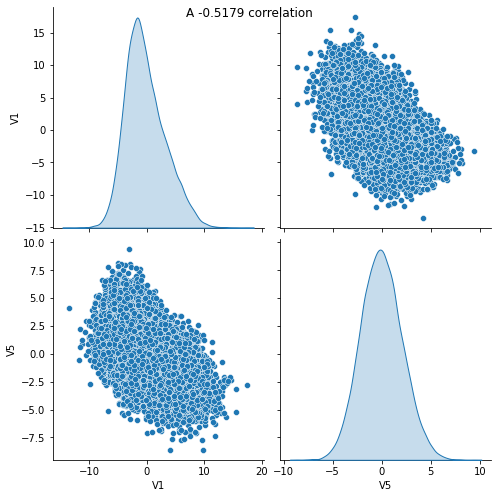

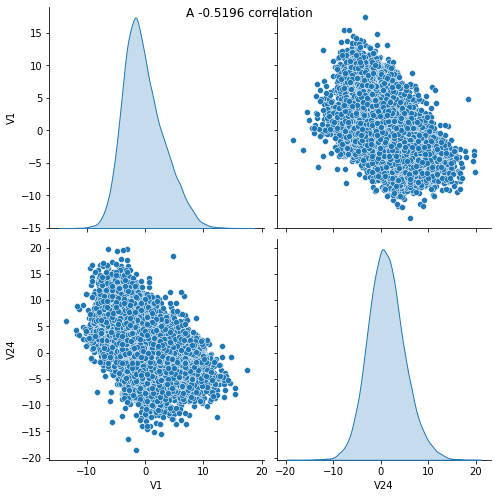

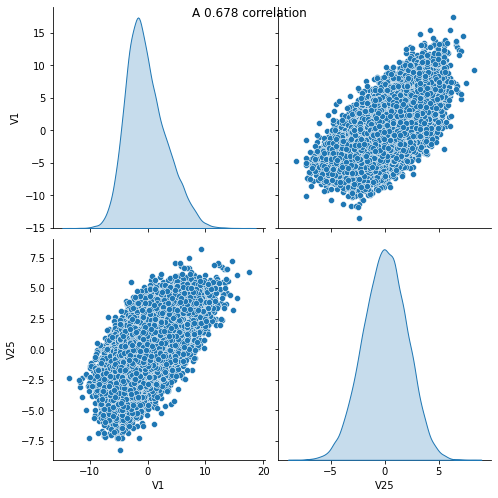

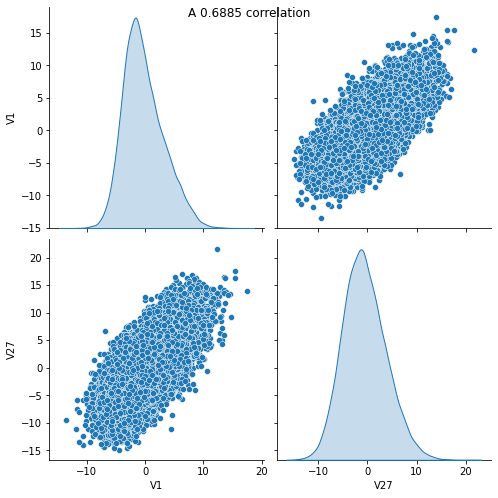

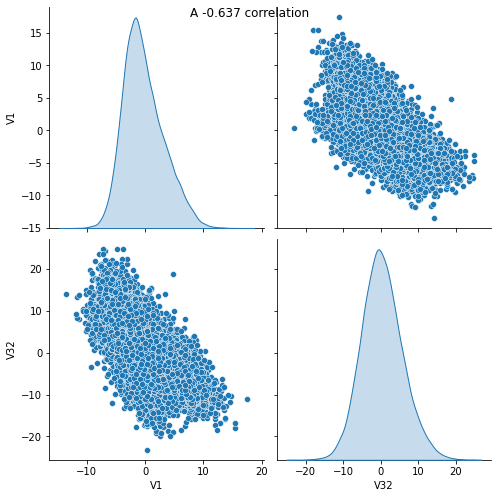

...

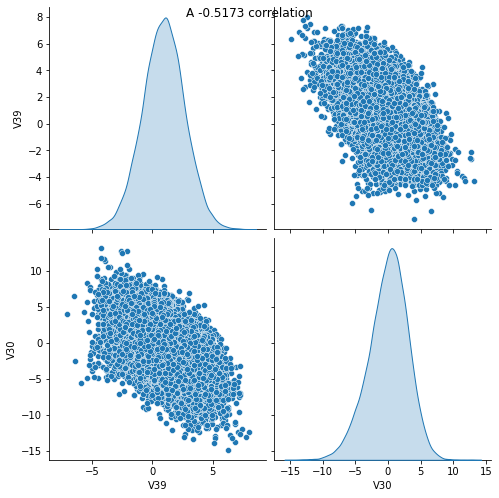

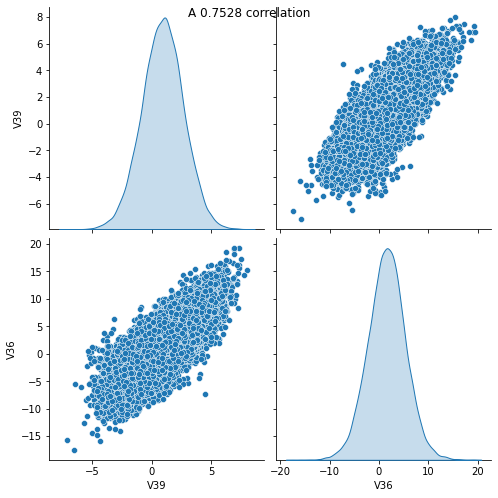

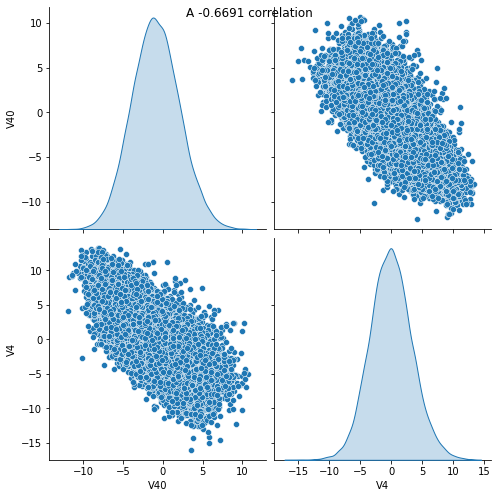

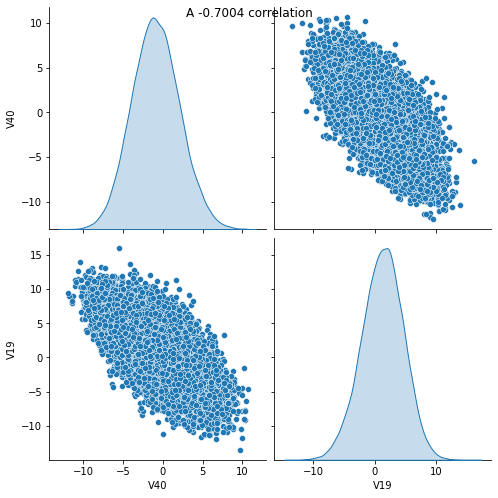

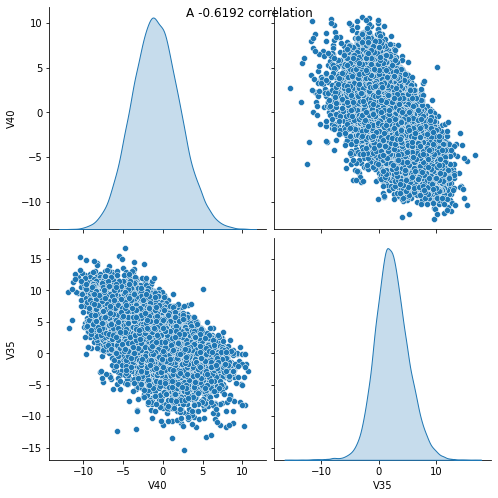

In [45]:
for s in corr_pairs:
    if (s[0] != s[1]):
        pp = sns.pairplot(df_train[[s[0],s[1]]], height=3.5, diag_kind="kde")
        pp.fig.suptitle(f"A {round(s[2],4)} correlation")
        plt.show()
    
    

### V1 is very highly positively correlated with V27
### V2 is very highly negatively correlated with V14

## EDA

### Plotting histograms and boxplots for all the variables

In [18]:
# function to plot a boxplot and a histogram along the same scale.


def histogram_boxplot(data, feature, figsize=(12, 7), kde=False, bins=None):
    """
    Boxplot and histogram combined

    data: dataframe
    feature: dataframe column
    figsize: size of figure (default (12,7))
    kde: whether to the show density curve (default False)
    bins: number of bins for histogram (default None)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=True,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots
    sns.boxplot(
        data=data, x=feature, ax=ax_box2, showmeans=True, color="violet"
    )  # boxplot will be created and a star will indicate the mean value of the column
    sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2, bins=bins, palette="winter"
    ) if bins else sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2
    )  # For histogram
    ax_hist2.axvline(
        data[feature].mean(), color="green", linestyle="--"
    )  # Add mean to the histogram
    ax_hist2.axvline(
        data[feature].median(), color="black", linestyle="-"
    )  # Add median to the histogram

### Plotting all the features at one go

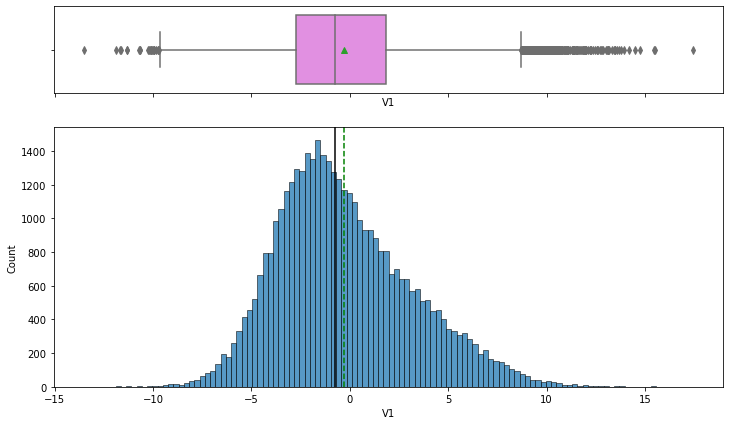

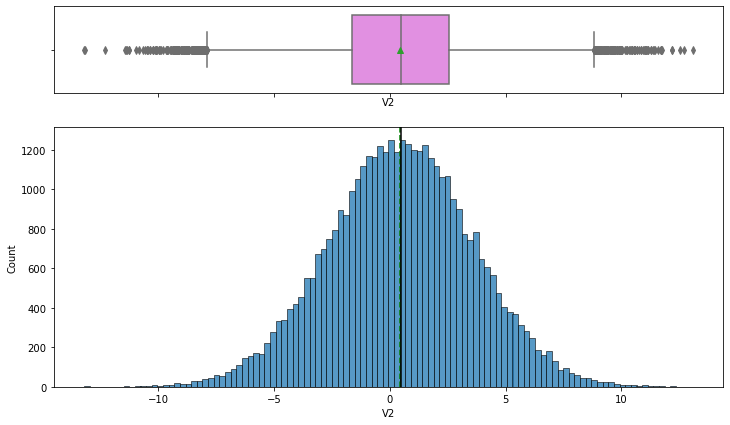

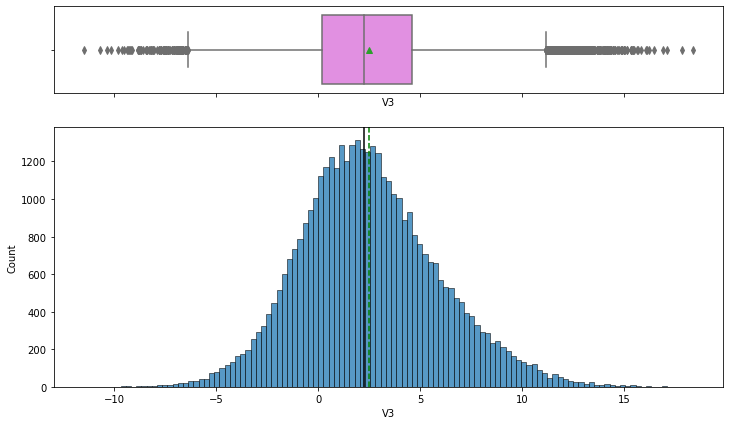

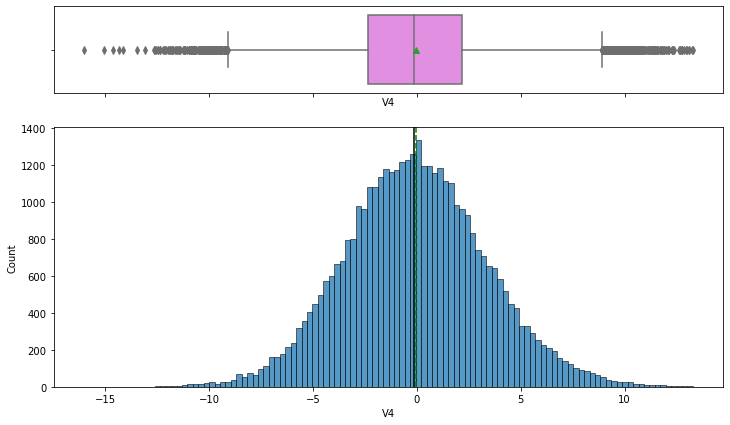

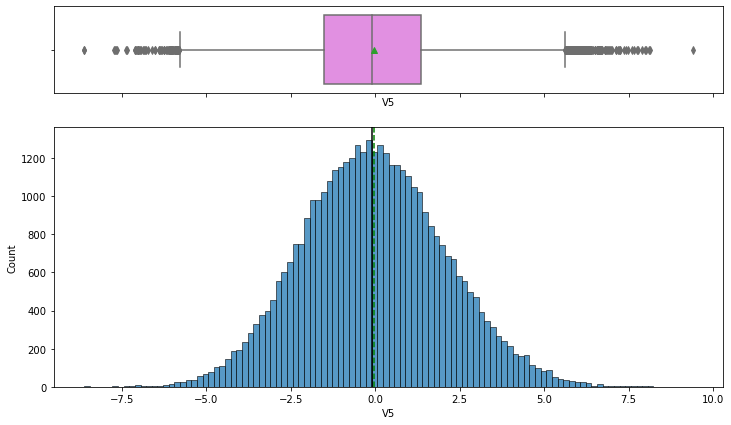

...

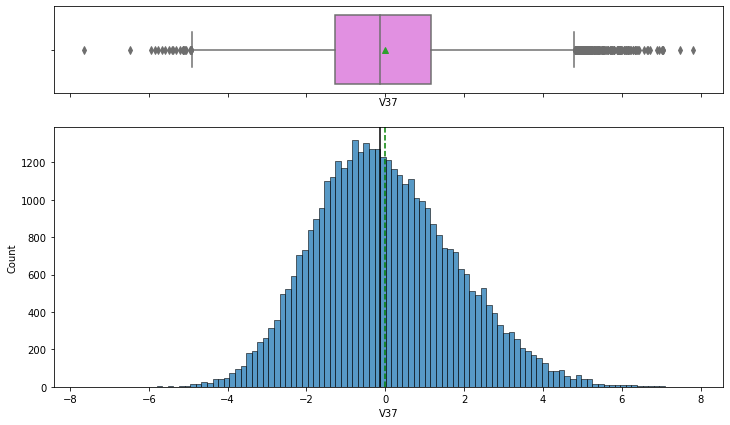

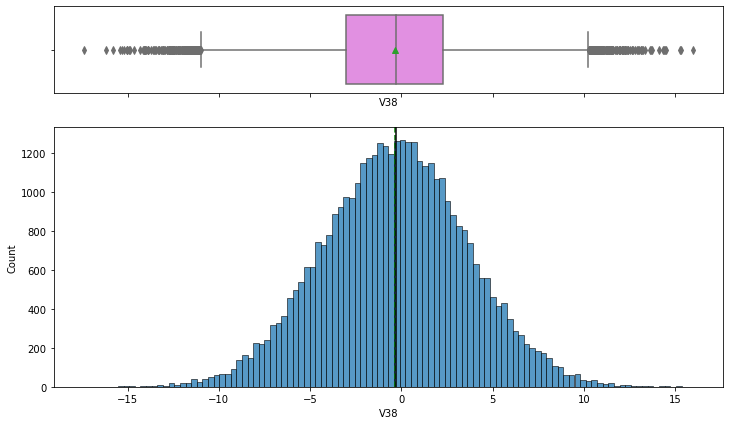

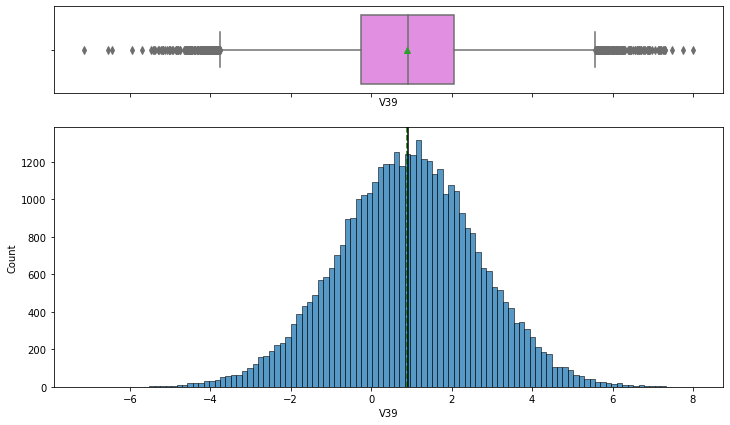

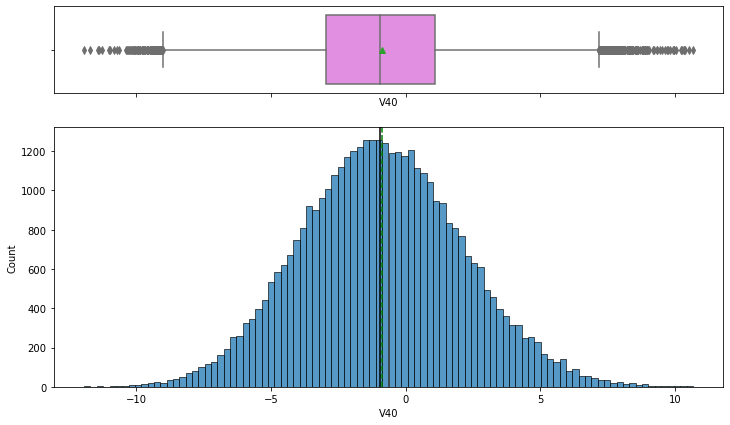

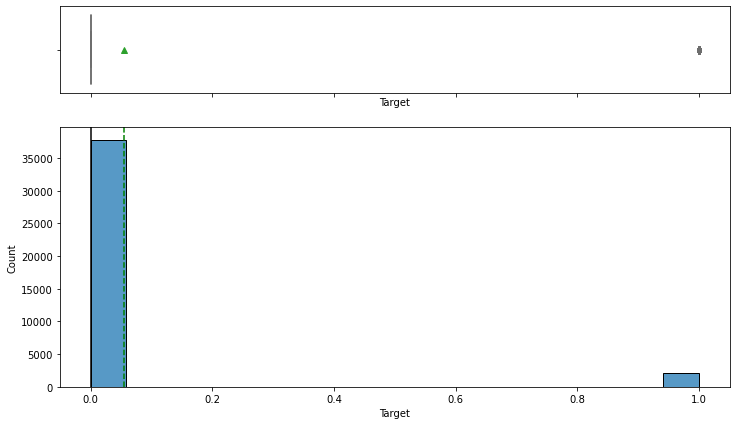

In [19]:
for feature in df_train.columns:
    histogram_boxplot(df_train, feature, figsize=(12, 7), kde=False, bins=None) ## Please change the dataframe name as you define while reading the data

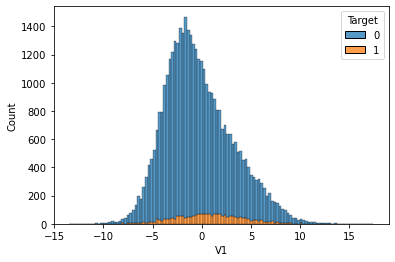

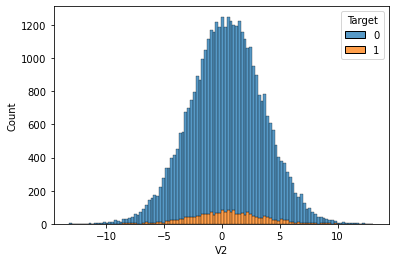

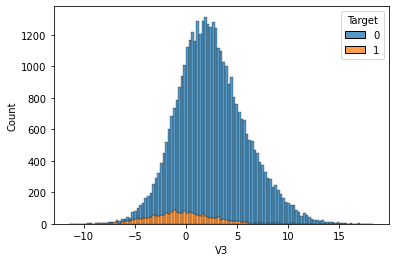

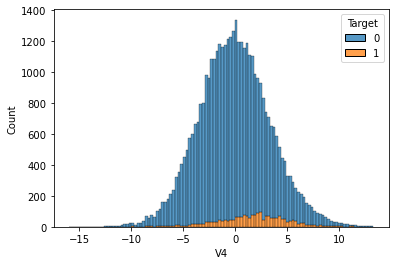

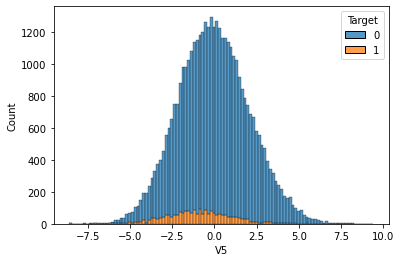

...

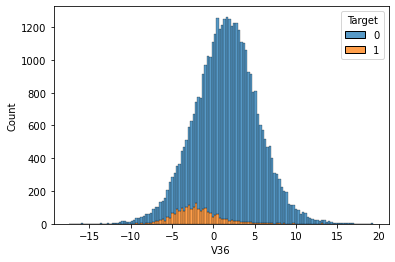

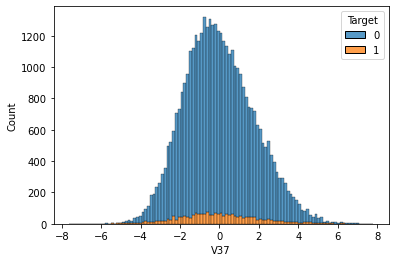

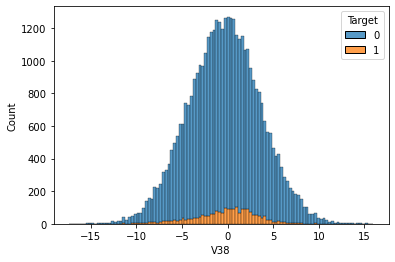

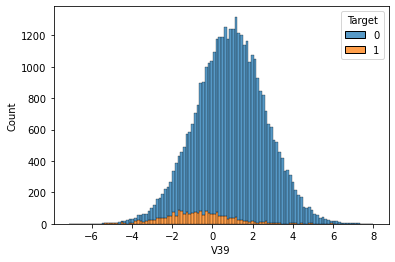

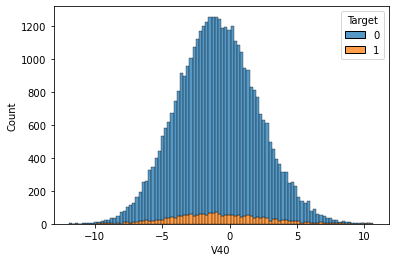

In [20]:
for f in df_train.columns:
    if(f == 'Target'):
        continue
    sns.histplot(x=df_train[f], hue=df_train.Target, multiple='stack')
    plt.show()

In [21]:
# function to create labeled barplots


def labeled_barplot(data, feature, perc=False, n=None):
    """
    Barplot with percentage at the top

    data: dataframe
    feature: dataframe column
    perc: whether to display percentages instead of count (default is False)
    n: displays the top n category levels (default is None, i.e., display all levels)
    """

    total = len(data[feature])  # length of the column
    count = data[feature].nunique()
    if n is None:
        plt.figure(figsize=(count + 1, 5))
    else:
        plt.figure(figsize=(n + 1, 5))

    plt.xticks(rotation=90, fontsize=15)
    ax = sns.countplot(
        data=data,
        x=feature,
        palette="Paired",
        order=data[feature].value_counts().index[:n].sort_values(),
    )

    for p in ax.patches:
        if perc == True:
            label = "{:.1f}%".format(
                100 * p.get_height() / total
            )  # percentage of each class of the category
        else:
            label = p.get_height()  # count of each level of the category

        x = p.get_x() + p.get_width() / 2  # width of the plot
        y = p.get_height()  # height of the plot

        ax.annotate(
            label,
            (x, y),
            ha="center",
            va="center",
            size=12,
            xytext=(0, 5),
            textcoords="offset points",
        )  # annotate the percentage

    plt.show()  # show the plot

## Split Data - this will help avoid data leakage 

In [22]:
# get the predictor variablesfrom the data set by excluding the target variable
X = df_train.drop(["Target"], axis=1)
# get the target variable
y = df_train["Target"]

In [23]:
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, random_state=1, stratify=y)

In [24]:
print("Number of rows in train data =", X_train.shape[0])
print("Number of rows in validation data =", X_val.shape[0])

Number of rows in train data = 28000
Number of rows in validation data = 12000


In [25]:
print("Percentage of classes in training set:")
print(y_train.value_counts(normalize=True))
print("Percentage of classes in validation set:")
print(y_val.value_counts(normalize=True))

Percentage of classes in training set:
0    0.945321
1    0.054679
Name: Target, dtype: float64
Percentage of classes in validation set:
0    0.945333
1    0.054667
Name: Target, dtype: float64


##  Rectification: Analysis has shown that V1 and V2 with missing values are correlated with some other predictor variables and therefore MICE might be a good candidate for replacing the missing data.

In [26]:
# instantiate the Imputer class
imputer = IterativeImputer(missing_values=np.nan, max_iter=10, verbose=2, imputation_order='roman',random_state=0)
# fit and transform the training data

In [27]:
# review the presence of missing values in training and test sets
X_train[['V1','V2']].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 28000 entries, 417 to 23406
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   V1      27960 non-null  float64
 1   V2      27981 non-null  float64
dtypes: float64(2)
memory usage: 656.2 KB


In [28]:
 X_val[['V1','V2']].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12000 entries, 5298 to 38738
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   V1      11994 non-null  float64
 1   V2      11980 non-null  float64
dtypes: float64(2)
memory usage: 281.2 KB


### In both the train and validation data there are fewer non-null values than the total number of records, therefore there are missing values present in both sets of data

In [29]:
# fit and transform the training data
X_train[['V1','V2']] = imputer.fit_transform(X_train[['V1','V2']])

# transform the validation data
X_val[['V1','V2']] = imputer.transform(X_val[['V1','V2']])

[IterativeImputer] Completing matrix with shape (28000, 2)
[IterativeImputer] Ending imputation round 1/10, elapsed time 0.01
[IterativeImputer] Change: 2.443267857852161, scaled tolerance: 0.015476277980000001 
[IterativeImputer] Ending imputation round 2/10, elapsed time 0.01
[IterativeImputer] Change: 0.0016080647345728671, scaled tolerance: 0.015476277980000001 
[IterativeImputer] Early stopping criterion reached.
[IterativeImputer] Completing matrix with shape (12000, 2)
[IterativeImputer] Ending imputation round 1/2, elapsed time 0.00
[IterativeImputer] Ending imputation round 2/2, elapsed time 0.00


In [30]:
# check to ensure the missing values have been replaced
X_train[['V1','V2']].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 28000 entries, 417 to 23406
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   V1      28000 non-null  float64
 1   V2      28000 non-null  float64
dtypes: float64(2)
memory usage: 656.2 KB


In [31]:
X_val[['V1','V2']].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12000 entries, 5298 to 38738
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   V1      12000 non-null  float64
 1   V2      12000 non-null  float64
dtypes: float64(2)
memory usage: 281.2 KB


### There are nolonger missing values in train or validation data

### Review the data distribution after the replacement of missing values to ensure there is nothing unusual

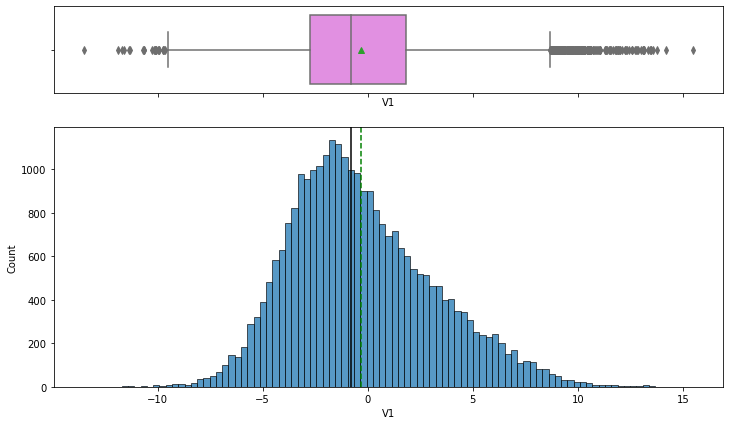

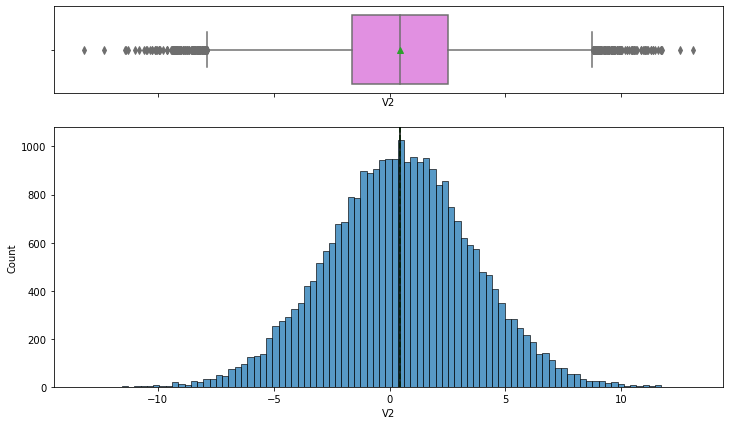

In [32]:
for feature in X_train[['V1','V2']]:
    histogram_boxplot(X_train[['V1','V2']], feature, figsize=(12, 7), kde=False, bins=None) ## Please change the dataframe name as you define while reading the data

## There are no oddities

## Data Pre-processing: Outliers will be examined and treated accordingly



### Outliers will be treated using KNN nearest neighbor algorithm - after they are replaced with NaNs 
* Most of the dimensions have a normal distribution, therefore it is important to preserve that characteristic of the data
* KNN is least likely to bias the data

In [33]:
# outlierToNan :replaces outliers with null values
# iqr is  equal to .75 percentile - .25 percentile
# return Series object where outliers have been changed to NaNs
def outlierToNan(df,col):  
    # to be more robust when called from custom transformer class
    q1 = df[col].quantile(0.25)  # 25th quantile
    q3 = df[col].quantile(0.75)  # 75th quantile  
    # calculate interquartile range iqr - difference btw third and first quartile
    iqr = q3 - q1
    # establish lower and upper limits of distribution
    lower_lim = q1 - 1.5 * iqr
    upper_lim = q3 + 1.5 * iqr   
    df[col] = df[col].apply(lambda x: np.NaN if((x < lower_lim) or (x > upper_lim)) else x)  
        
    return df

In [34]:
def remove_outliers_all(df, col_list):  
    for col in col_list:
        df = outlierToNan(df,col)
    return df

In [35]:
# replace outliers in the training set with nulls
X_train = remove_outliers_all(X_train, X_train.columns)

In [36]:
#  replace outliers in the validation set with nulls
X_val = remove_outliers_all(X_val, X_val.columns)

In [38]:
imputer2 = KNNImputer(missing_values=np.NaN, n_neighbors=5)

In [39]:
# Fit and transform the train data
X_train[X_train.columns] = imputer2.fit_transform(X_train[X_train.columns])

# Transform the train data
X_val[X_train.columns] = imputer2.transform(X_val[X_train.columns])

### Verify visually that the outliers have been treated through the boxplots

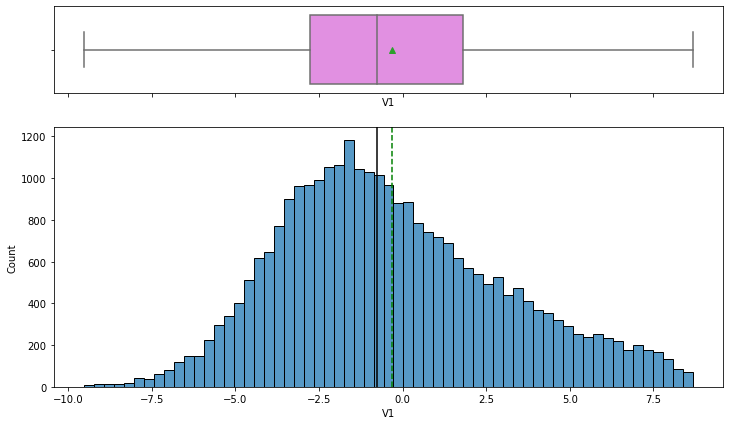

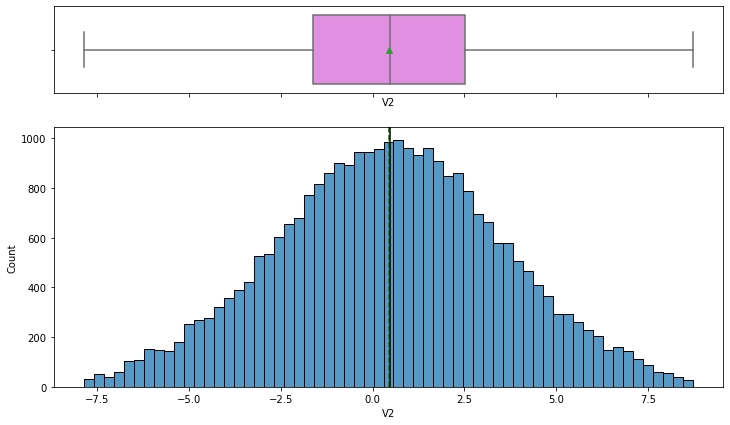

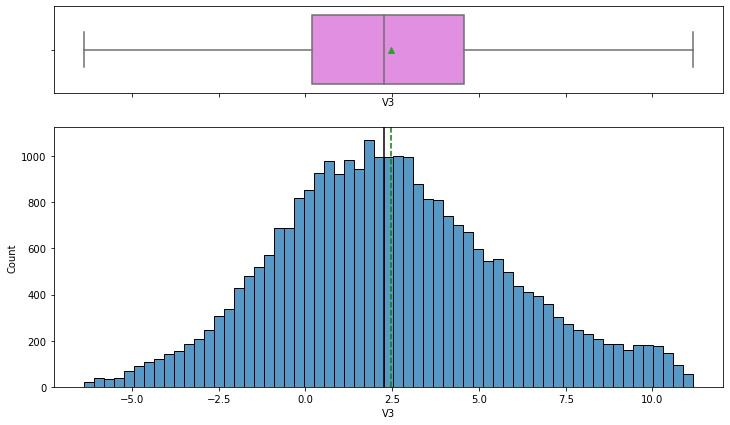

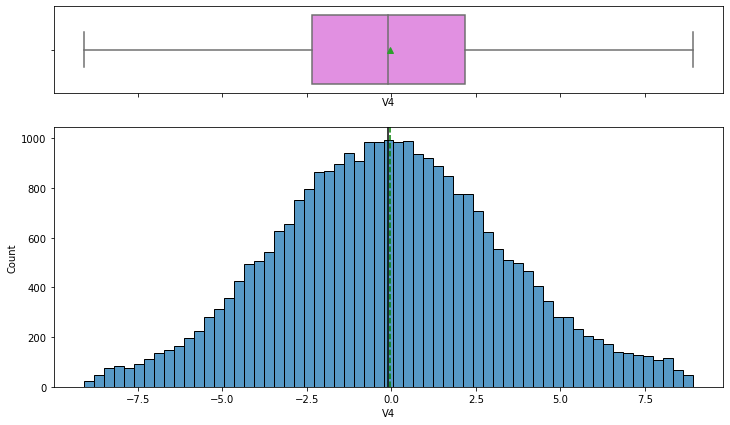

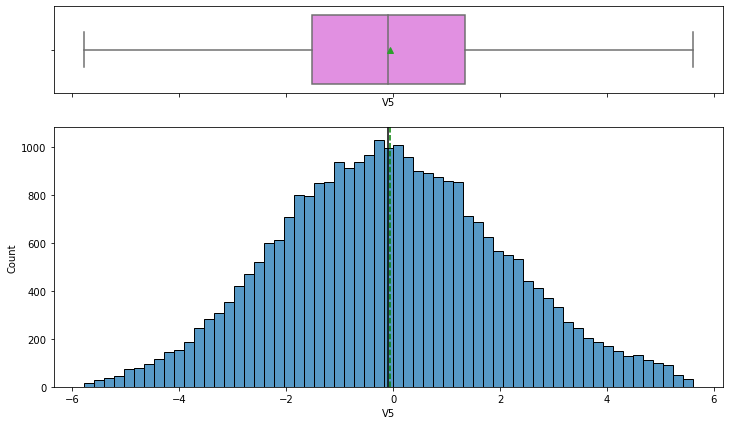

...

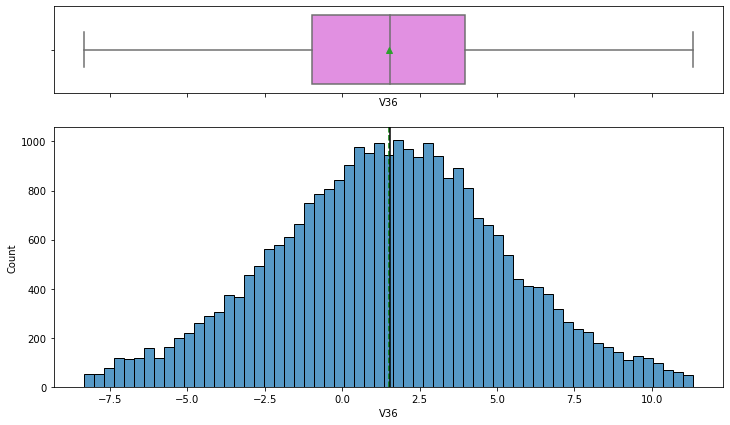

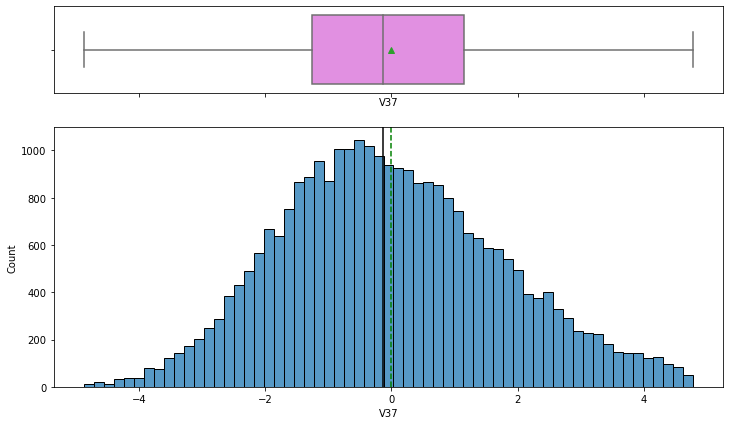

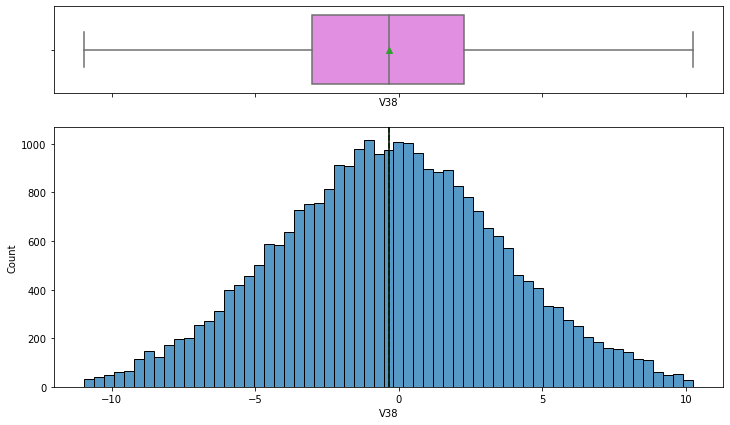

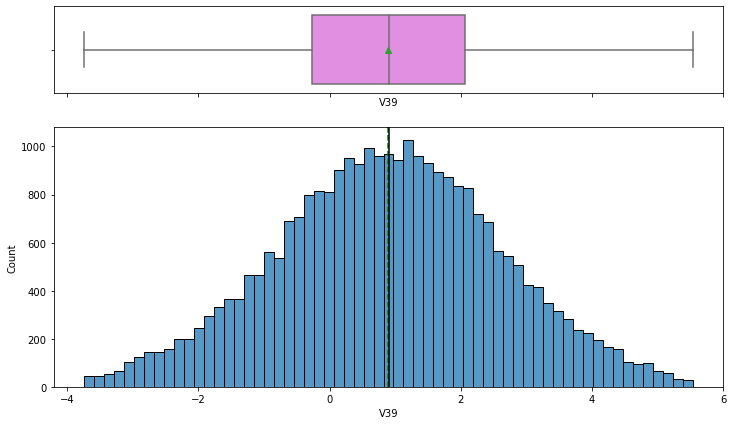

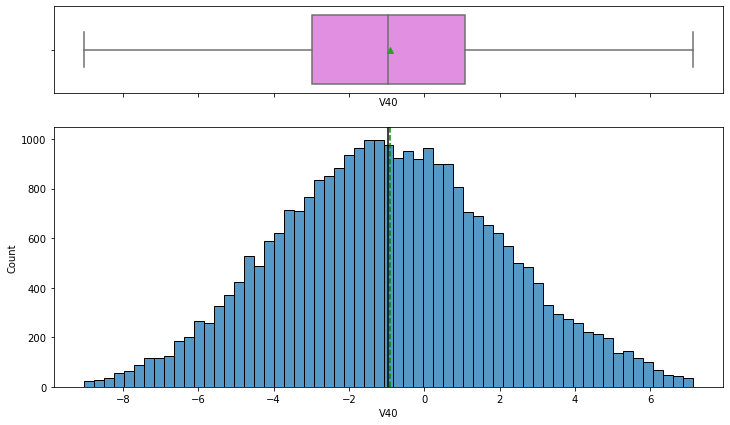

In [40]:
for feature in X_train:
    histogram_boxplot(X_train, feature, figsize=(12, 7), kde=False, bins=None) ## Please change the dataframe name as you define while reading the data

### The outlier treatment has not significantly changed the characteristics of the distributions of data in the predictors. V34 is somewhat of an exception because the left tail of the distribution has a spike of values.

## Model Building

### Model evaluation criterion

The nature of predictions made by the classification model will translate as follows:

- True positives (TP) are failures correctly predicted by the model.
- False negatives (FN) are real failures in a generator where there is no detection by model. 
- False positives (FP) are failure detections in a generator where there is no failure.

### Which metric to optimize?

* We need to choose the metric which will ensure that the maximum number of generator failures are predicted correctly by the model.
* We would want Recall to be maximized as greater the Recall, the higher the chances of minimizing false negatives.
* We want to minimize false negatives because if a model predicts that a machine will have no failure when there will be a failure, it will increase the maintenance cost.


**Let's define a function to output different metrics (including recall) on the train and test set and a function to show confusion matrix so that we do not have to use the same code repetitively while evaluating models.**

In [41]:
# defining a function to compute different metrics to check performance of a classification model built using sklearn
def model_performance_classification_sklearn(model, predictors, target):
    """
    Function to compute different metrics to check classification model performance

    model: classifier
    predictors: independent variables
    target: dependent variable
    """

    # predicting using the independent variables
    pred = model.predict(predictors)

    acc = accuracy_score(target, pred)  # to compute Accuracy
    recall = recall_score(target, pred)  # to compute Recall
    precision = precision_score(target, pred)  # to compute Precision
    f1 = f1_score(target, pred)  # to compute F1-score

    # creating a dataframe of metrics
    df_perf = pd.DataFrame(
        {
            "Accuracy": acc,
            "Recall": recall,
            "Precision": precision,
            "F1": f1
            
        },
        index=[0],
    )

    return df_perf

In [42]:
def confusion_matrix_sklearn(model, predictors, target):
    """
    To plot the confusion_matrix with percentages

    model: classifier
    predictors: independent variables
    target: dependent variable
    """
    y_pred = model.predict(predictors)
    cm = confusion_matrix(target, y_pred)
    labels = np.asarray(
        [
            ["{0:0.0f}".format(item) + "\n{0:.2%}".format(item / cm.flatten().sum())]
            for item in cm.flatten()
        ]
    ).reshape(2, 2)

    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=labels, fmt="")
    plt.ylabel("True label")
    plt.xlabel("Predicted label")

### Defining scorer to be used for cross-validation and hyperparameter tuning

- We want to reduce false negatives and will try to maximize "Recall".
- To maximize Recall, we can use Recall as a **scorer** in cross-validation and hyperparameter tuning.

In [43]:
# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

### Model Building with original  data

In [44]:
models = []  # Empty list to store all the models

# Appending models into the list
#models.append(("dTree", DecisionTreeClassifier(random_state=1)))
models.append(("lgReg", LogisticRegression(random_state=1)))
#models.append(("bgClas", BaggingClassifier(random_state=1)))
models.append(("rndFor", RandomForestClassifier(random_state=1)))
models.append(("adaBst", AdaBoostClassifier(random_state=1)))
models.append(("grdBst", GradientBoostingClassifier(random_state=1)))
models.append(("xgBst", XGBClassifier(random_state=1)))
models.append(("xgBst", XGBClassifier(random_state=1)))
              
results1 = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation Cost:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=X_train, y=y_train, scoring=scorer, cv=kfold
    )
    results1.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" "Validation Performance:" "\n")

for name, model in models:
    model.fit(X_train, y_train)
    scores = recall_score(y_val, model.predict(X_val))
    print("{}: {}".format(name, scores))


Cross-Validation Cost:

lgReg: 0.5499733878350472
rndFor: 0.7452619701517957
adaBst: 0.5930936109514381
grdBst: 0.7086734368014306
[16:01:53] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[16:02:15] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[16:02:25] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[16:02:46] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with t

### Model Building with Oversampled data


In [45]:
# Synthetic Minority Over Sampling Technique
sm = SMOTE(sampling_strategy=1, k_neighbors=5, random_state=1)
X_train_over, y_train_over = sm.fit_resample(X_train, y_train)

In [46]:
print("Before OverSampling, count of label '1': {}".format(sum(y_train == 1)))
print("Before OverSampling, count of label '0': {} \n".format(sum(y_train == 0)))

print("After OverSampling, count of label '1': {}".format(sum(y_train_over == 1)))
print("After OverSampling, count of label '0': {} \n".format(sum(y_train_over == 0)))

print("After OverSampling, the shape of train_X: {}".format(X_train_over.shape))
print("After OverSampling, the shape of train_y: {} \n".format(y_train_over.shape))

Before OverSampling, count of label '1': 1531
Before OverSampling, count of label '0': 26469 

After OverSampling, count of label '1': 26469
After OverSampling, count of label '0': 26469 

After OverSampling, the shape of train_X: (52938, 40)
After OverSampling, the shape of train_y: (52938,) 



### Model Building with Undersampled data

In [61]:
# Random undersampler for under sampling the data
rus = RandomUnderSampler(random_state=1, sampling_strategy=1)
X_train_un, y_train_un = rus.fit_resample(X_train, y_train)

In [ ]:
print("Before Under Sampling, count of label '1': {}".format(sum(y_train == 1)))
print("Before Under Sampling, count of label '0': {} \n".format(sum(y_train == 0)))

print("After Under Sampling, count of label '1': {}".format(sum(y_train_un == 1)))
print("After Under Sampling, count of label '0': {} \n".format(sum(y_train_un == 0)))

print("After Under Sampling, the shape of train_X: {}".format(X_train_un.shape))
print("After Under Sampling, the shape of train_y: {} \n".format(y_train_un.shape))

### Performance using over sampled data

In [47]:
models = []  # Empty list to store all the models

# Appending models into the list
#models.append(("dTree", DecisionTreeClassifier(random_state=1)))
models.append(("lgReg", LogisticRegression(random_state=1)))
#models.append(("bgClas", BaggingClassifier(random_state=1)))
models.append(("rndFor", RandomForestClassifier(random_state=1)))
models.append(("adaBst", AdaBoostClassifier(random_state=1)))
models.append(("grdBst", GradientBoostingClassifier(random_state=1)))
models.append(("knn", KNeighborsClassifier(n_neighbors=3)))
models.append(("xgBst", XGBClassifier(random_state=1)))
              
results1 = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation Cost:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=X_train_over, y=y_train_over, scoring=scorer, cv=kfold
    )
    results1.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" "Validation Performance:" "\n")

for name, model in models:
    model.fit(X_train_over, y_train_over)
    scores = recall_score(y_val, model.predict(X_val))
    print("{}: {}".format(name, scores))


Cross-Validation Cost:

lgReg: 0.8789148850535785
rndFor: 0.9815256423167906
adaBst: 0.8915710644484083
grdBst: 0.9157505572042709
knn: 0.9978087830967061
[16:40:39] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[16:41:20] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[16:42:02] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[16:42:43] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evalu

### Performance using under sampled data

In [ ]:
models = []  # Empty list to store all the models

# Appending models into the list
#models.append(("dTree", DecisionTreeClassifier(random_state=1)))
models.append(("lgReg", LogisticRegression(random_state=1)))
#models.append(("bgClas", BaggingClassifier(random_state=1)))
models.append(("rndFor", RandomForestClassifier(random_state=1)))
models.append(("adaBst", AdaBoostClassifier(random_state=1)))
models.append(("grdBst", GradientBoostingClassifier(random_state=1)))
models.append(("knn", KNeighborsClassifier(n_neighbors=3)))
models.append(("xgBst", XGBClassifier(random_state=1)))
              
results1 = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Cross-Validation Cost:" "\n")

for name, model in models:
    kfold = StratifiedKFold(
        n_splits=5, shuffle=True, random_state=1
    )  # Setting number of splits equal to 5
    cv_result = cross_val_score(
        estimator=model, X=X_train_un, y=y_train_un, scoring=scorer, cv=kfold
    )
    results1.append(cv_result)
    names.append(name)
    print("{}: {}".format(name, cv_result.mean()))

print("\n" "Validation Performance:" "\n")

for name, model in models:
    model.fit(X_train_un, y_train_un)
    scores = recall_score(y_val, model.predict(X_val))
    print("{}: {}".format(name, scores))

In [ ]:
# defining a function to compute different metrics to check performance of a classification model built using sklearn
def model_performance_classification_sklearn(model, predictors, target):
    """
    Function to compute different metrics to check classification model performance

    model: classifier
    predictors: independent variables
    target: dependent variable
    """

    # predicting using the independent variables
    pred = model.predict(predictors)

    acc = accuracy_score(target, pred)  # to compute Accuracy
    recall = recall_score(target, pred)  # to compute Recall
    precision = precision_score(target, pred)  # to compute Precision
    f1 = f1_score(target, pred)  # to compute F1-score

    # creating a dataframe of metrics
    df_perf = pd.DataFrame(
        {"Accuracy": acc, "Recall": recall, "Precision": precision, "F1": f1,},
        index=[0],
    )

    return df_perf

## HyperparameterTuning 

### Tuning the models with oversampled data

In [24]:
model = KNeighborsClassifier(n_neighbors=3)

models = []  # Empty list to store all the models

# Appending models into the list
# set hyper params for decision tree classifier
param_grid = { 'max_depth': np.arange(2,6), 'min_samples_leaf': [1, 4, 7], 'max_leaf_nodes' : [10, 15], \
              'min_impurity_decrease': [0.0001,0.001] }
models.append(("dTree", DecisionTreeClassifier(random_state=1), param_grid))
# set hyper params for logistic regression classifier
param_grid = {'C': np.arange(0.1,1.1,0.1)}
models.append(("lgReg", LogisticRegression(random_state=1), param_grid))
# set hyper params for bagging classifier
# param_grid = { 'max_samples': [0.8,0.9,1], 'max_features': [0.7,0.8,0.9], 'n_estimators' : [30,50,70]}
# models.append(("bgClas", BaggingClassifier(random_state=1), param_grid))
# set hyper params for random forest classifier
param_grid = { "n_estimators": [200,250,300], "min_samples_leaf": np.arange(1, 4), "max_features": \
              [np.arange(0.3, 0.6, 0.1),'sqrt'], "max_samples": np.arange(0.4, 0.7, 0.1) }
models.append(("rndFor", RandomForestClassifier(random_state=1), param_grid))
# set hyper params for ADA boost classifier
param_grid = { "n_estimators": [100, 150, 200], "learning_rate": [0.2, 0.05], "base_estimator": \
              [DecisionTreeClassifier(max_depth=1, random_state=1), DecisionTreeClassifier(max_depth=2, random_state=1), \
               DecisionTreeClassifier(max_depth=3, random_state=1)] }
models.append(("adaBst", AdaBoostClassifier(random_state=1), param_grid))
# set hyper params for gradient boost classifier
param_grid = { "n_estimators": np.arange(100,150,25), "learning_rate": [0.2, 0.05, 1], "subsample":[0.5,0.7], \
              "max_features":[0.5,0.7] }
models.append(("grdBst", GradientBoostingClassifier(random_state=1), param_grid))
# set hyper parameters for K nearest neighbor classifier
param_grid = {'n_neighbors': np.arange(3,5,1)}
models.append(("knn", KNeighborsClassifier(n_neighbors=3), param_grid))
# set hyper params for xgboost classifier
param_grid={ 'n_estimators': [150, 200, 250], 'scale_pos_weight': [5,10], 'learning_rate': [0.1,0.2], 'gamma': \
            [0,3,5], 'subsample': [0.8,0.9] }
models.append(("xgBst", XGBClassifier(random_state=1), param_grid))
              
results1 = []  # Empty list to store all model scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Over sampled data - RandomizedSearchCV tuning:" "\n")

kfold = StratifiedKFold(
    n_splits=5, shuffle=True, random_state=1
)  # Setting number of splits equal to 5

for name, model, params in models:
# calling RandomizedSearchCV

    randomized_cv = RandomizedSearchCV(estimator=model, param_distributions=params, \
                                   n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

    # fitting parameters in RandomizedSearchCV
    randomized_cv.fit(X_train_over,y_train_over)   
    
    # predicting on train and validation
    pred_train = randomized_cv.best_estimator_.predict(X_train_over)
    pred_val = randomized_cv.best_estimator_.predict(X_val)
        
    # recall of the model
    train_recall = metrics.recall_score(y_train_over,pred_train)
    val_recall = metrics.recall_score(y_val,pred_val)
            
    print(f"{name} : Recall on training set : {randomized_cv.best_score_}")    
    print(f"{name} : Recall on validation set : {metrics.recall_score(y_val,pred_val)}")
    # XG Boost is  the best performer, so the XG Boost tuned instance with the highest recall score
    # will be saved so its the feature importances can be reviewed
    if (name == "xgBst"):
        thebest = randomized_cv.best_estimator_
        importances = randomized_cv.best_estimator_.feature_importances_
#     if (name == "lgReg"):
#         importances2 = randomized_cv.estimator.feature_importances_
    


Over sampled data - RandomizedSearchCV tuning:

dTree : Recall on training set : 0.8600250268172511
dTree : Recall on validation set : 0.8216463414634146
lgReg : Recall on training set : 0.8795949144399611
lgReg : Recall on validation set : 0.836890243902439
rndFor : Recall on training set : 0.9782765456168775
rndFor : Recall on validation set : 0.8612804878048781
adaBst : Recall on training set : 0.947410159086307
adaBst : Recall on validation set : 0.8673780487804879
grdBst : Recall on training set : 0.9541725672708129
grdBst : Recall on validation set : 0.850609756097561
knn : Recall on training set : 0.9978087830967061
knn : Recall on validation set : 0.864329268292683
[20:16:56] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
xgBst : Recall on training set : 0.9956175376435408
xgBst : Recal

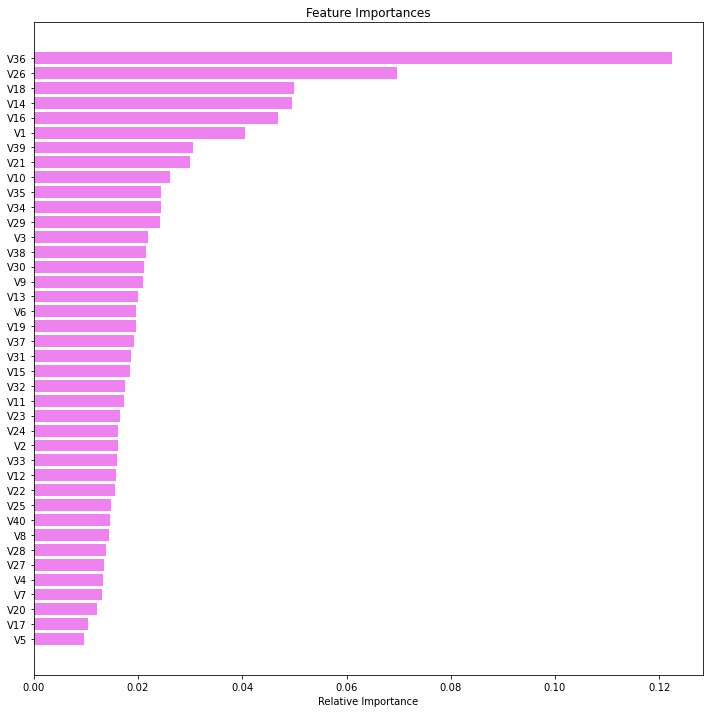

In [25]:
feature_names = X.columns
indices = np.argsort(importances)

plt.figure(figsize=(12, 12))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color="violet", align="center")
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

### The 12 most important features in predicting failure in respective order are: 
### V36, V26, V18, V14, V16, V1, V39, V21, V10, V35, V34, V29

### Using statsmodels library we shall excute a logistic regression so that we can further analize the data. In particular we want to do the following:

* View the coefficients of the independent variables

In [50]:
# import useful statsmodel library functionality that provides detailed metrics
import statsmodels.stats.api as sms
from statsmodels.stats.outliers_influence import variance_inflation_factor
import statsmodels.api as sm2
from statsmodels.tools.tools import add_constant


### We redo all the preprocessing using the original X - predictors, and y - target

In [51]:
# adding constant is required by statsmodel which does not do generate an intercept for the best fit curve by default 
X2 = sm2.add_constant(X)

# splitting in training and test set
X_train2, X_val2, y_train2, y_val2 = train_test_split(X2, y, test_size=0.3, random_state=3)

In [35]:
# instantiate the Imputer class which an experimental MICE for python
# It is used to fill null values in V1 and V2, both V1  and V2 have collinearities with other predictors
# that can be used to predict their values
imputer = IterativeImputer(missing_values=np.nan, max_iter=10, verbose=2, imputation_order='roman',random_state=0)
# fit and transform the training data
X_train2[['V1','V2']] = imputer.fit_transform(X_train2[['V1','V2']])

# transform the validation data
X_val2[['V1','V2']] = imputer.transform(X_val2[['V1','V2']])

[IterativeImputer] Completing matrix with shape (28000, 2)
[IterativeImputer] Ending imputation round 1/10, elapsed time 0.01
[IterativeImputer] Change: 2.492750093612277, scaled tolerance: 0.017436981060000002 
[IterativeImputer] Ending imputation round 2/10, elapsed time 0.02
[IterativeImputer] Change: 0.002102644396273279, scaled tolerance: 0.017436981060000002 
[IterativeImputer] Early stopping criterion reached.
[IterativeImputer] Completing matrix with shape (12000, 2)
[IterativeImputer] Ending imputation round 1/2, elapsed time 0.00
[IterativeImputer] Ending imputation round 2/2, elapsed time 0.00


In [52]:
#  replace outliers in the validation set with nulls
X_val2 = remove_outliers_all(X_val2, X_val2.columns)

imputer2 = KNNImputer(missing_values=np.NaN, n_neighbors=5)

# Fit and transform the train data
X_train2[X_train2.columns] = imputer2.fit_transform(X_train2[X_train2.columns])

# Transform the train data
X_val2[X_train2.columns] = imputer2.transform(X_val2[X_train2.columns])

In [53]:
# Synthetic Minority Over Sampling Technique to balance the data between the target classes
sm = SMOTE(sampling_strategy=1, k_neighbors=5, random_state=1)
X_train_over2, y_train_over2 = sm.fit_resample(X_train2, y_train2)

### Instantiate and execute the statsmodels logistic regression 

In [54]:
logit = sm2.Logit(y_train_over2, X_train_over2.astype(float))
lg = logit.fit(
    disp=False
)  # setting disp=False will remove the information on number of iterations

print(lg.summary())

                           Logit Regression Results                           
Dep. Variable:                 Target   No. Observations:                52986
Model:                          Logit   Df Residuals:                    52945
Method:                           MLE   Df Model:                           40
Date:                Fri, 21 Jan 2022   Pseudo R-squ.:                  0.5119
Time:                        17:30:34   Log-Likelihood:                -17926.
converged:                      False   LL-Null:                       -36727.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.5497      0.018     30.578      0.000       0.514       0.585
V1             0.3399      0.509      0.667      0.505      -0.658       1.338
V2            -0.4752      1.477     -0.322      0.7

C:\Users\uchenna.Nwosu4J\anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


### The results are unreliable:

* Some of the P - values are nulls
* Only V1 and V2 have plausible values yet they are much larger than the acceptable significance level of 0.05
* The P - values of 1 are suspect

Because of this even the coefficients cannot be relied upon

### Sample tuning the models using under sampled data

In [63]:
# # Train the model using the training sets
# model.fit(features,label)


models = []  # Empty list to store all the models

# Appending models into the list
# set hyper params for decision tree classifier
param_grid = { 'max_depth': np.arange(2,6), 'min_samples_leaf': [1, 4, 7], 'max_leaf_nodes' : [10, 15], \
              'min_impurity_decrease': [0.0001,0.001] }
models.append(("dTree", DecisionTreeClassifier(random_state=1), param_grid))
# set hyper params for logistic regression classifier
param_grid = {'C': np.arange(0.1,1.1,0.1)}
models.append(("lgReg", LogisticRegression(random_state=1), param_grid))
# # set hyper params for bagging classifier
# param_grid = { 'max_samples': [0.8,0.9,1], 'max_features': [0.7,0.8,0.9], 'n_estimators' : [30,50,70]}
# models.append(("bgClas", BaggingClassifier(random_state=1), param_grid))
# set hyper params for random forest classifier
param_grid = { "n_estimators": [200,250,300], "min_samples_leaf": np.arange(1, 4), "max_features": \
              [np.arange(0.3, 0.6, 0.1),'sqrt'], "max_samples": np.arange(0.4, 0.7, 0.1) }
models.append(("rndFor", RandomForestClassifier(random_state=1), param_grid))
# set hyper params for ADA boost classifier
param_grid = { "n_estimators": [100, 150, 200], "learning_rate": [0.2, 0.05], "base_estimator": \
              [DecisionTreeClassifier(max_depth=1, random_state=1), DecisionTreeClassifier(max_depth=2, random_state=1), \
               DecisionTreeClassifier(max_depth=3, random_state=1)] }
models.append(("adaBst", AdaBoostClassifier(random_state=1), param_grid))
# set hyper params for gradient boost classifier
param_grid = { "n_estimators": np.arange(100,150,25), "learning_rate": [0.2, 0.05, 1], "subsample":[0.5,0.7], \
              "max_features":[0.5,0.7] }
models.append(("grdBst", GradientBoostingClassifier(random_state=1), param_grid))
# set hyper parameters for K nearest neighbor classifier
param_grid = {'n_neighbors': np.arange(3,5,1)}
models.append(("knn", KNeighborsClassifier(n_neighbors=3), param_grid))
# set hyper params for xgboost classifier
param_grid={ 'n_estimators': [150, 200, 250], 'scale_pos_weight': [5,10], 'learning_rate': [0.1,0.2], 'gamma': \
            [0,3,5], 'subsample': [0.8,0.9] }
models.append(("xgBst", XGBClassifier(random_state=1), param_grid))
              
results1 = []  # Empty list to store all model's CV scores
names = []  # Empty list to store name of the models


# loop through all models to get the mean cross validated score
print("\n" "Under sampled data - RandomizedSearchCV tuning:" "\n")

kfold = StratifiedKFold(
    n_splits=5, shuffle=True, random_state=1
)  # Setting number of splits equal to 5

for name, model, params in models:
# calling RandomizedSearchCV
    randomized_cv = RandomizedSearchCV(estimator=model, param_distributions=params, \
                                   n_iter=10, n_jobs = -1, scoring=scorer, cv=kfold, random_state=1)

    # fitting parameters in RandomizedSearchCV
    randomized_cv.fit(X_train_un,y_train_un)   
    
    # predicting on train and validation
    pred_train = randomized_cv.best_estimator_.predict(X_train_un)
    pred_val = randomized_cv.best_estimator_.predict(X_val)
        
    # recall of the model
    train_recall = metrics.recall_score(y_train_un,pred_train)
    val_recall = metrics.recall_score(y_val,pred_val)
            
    print(f"{name} : Recall on training set : {randomized_cv.best_score_}")    
    print(f"{name} : Recall on validation set : {metrics.recall_score(y_val,pred_val)}")


Under sampled data - RandomizedSearchCV tuning:

dTree : Recall on training set : 0.8268995763343339
dTree : Recall on validation set : 0.8292682926829268
lgReg : Recall on training set : 0.8556321985906198
lgReg : Recall on validation set : 0.8384146341463414
rndFor : Recall on training set : 0.8935343084030573
rndFor : Recall on validation set : 0.8810975609756098
adaBst : Recall on training set : 0.8837261288880374
adaBst : Recall on validation set : 0.8917682926829268
grdBst : Recall on training set : 0.8968022822592664
grdBst : Recall on validation set : 0.885670731707317
knn : Recall on training set : 0.8876476975154883
knn : Recall on validation set : 0.8871951219512195
[19:25:25] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
xgBst : Recall on training set : 0.9163845777181665
xgBst : R

In [68]:
# get the best RandomcvSearch params for XG Boost
# to be used in production
randomized_cv.best_estimator_.get_xgb_params

<bound method XGBModel.get_xgb_params of XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              gamma=5, gpu_id=-1, importance_type=None,
              interaction_constraints='', learning_rate=0.1, max_delta_step=0,
              max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=200, n_jobs=4,
              num_parallel_tree=1, predictor='auto', random_state=1,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=10, subsample=0.8,
              tree_method='exact', validate_parameters=1, verbosity=None)>

## Model performance comparison and choosing the final model

### The XGB classifier is the best performing model: It has the highest recall score:

* The oversampled data has a higher F1 score
* The oversampled data is overfitting more than the undersampled data, however it has a very low F1
* The underv sampled data has a higher recall

## Pipelines to build the final model


###  Reset X and y values

In [64]:
# get the predictor variablesfrom the data set by excluding the target variable
X = df_train.drop(["Target"], axis=1)
# get the target variable
y = df_train["Target"]

### We don't have to split the training data again because we have conducted all our testing and have selected the best performing model

In [65]:
X_train = X

In [66]:
# get list of predictor column names
all_columns = df_train.drop('Target', axis=1).columns

In [67]:
# import ColumnTransformer classes used to derive a custom transformer that can be used in a pipeline
from sklearn.base import BaseEstimator, TransformerMixin

# custom transformer class for treating outliers
# it is derived from BaseEstimator, TransformerMixin, which
# are of type ColumnTransformer; therefore it has all the functionality
# of the ColumnTransformer class
# class treatOutliersTransformer implements its own fit and transform methods

class treatOutliersTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, param="nada"):  
        self.param = param
        
    def fit(self, X: pd.DataFrame, y = None):
        return self
    
    def transform(self, X: pd.DataFrame, y=None):
        X_ = X.copy()
        
        # the ColumnTransformer class places and returns parameters as ndarray 
        # therefore conversion is needed before I call the remove_outliers_all()
        result = pd.DataFrame(X, columns=all_columns)
        # remove all the outliers replacing them with NaNs
        X = remove_outliers_all(result, all_columns)
        # replace these NaN values using the K nearest neighbor algorithm
        imputer = KNNImputer(missing_values=np.NaN, n_neighbors=5)
        X = imputer.fit_transform(X)  
        # the processed data has to also be returned as a pandas DataFrame
        result = pd.DataFrame(X, columns=all_columns)
        return result
    

### Pipeline with undersampled data

In [71]:
from sklearn.compose import ColumnTransformer                    
# V1 and V2 are the only columns in the original data that have missing values
cols_with_mssg_values = ['V1','V2']

# subpipeline for filling missing data using MICE: IterativeImputer() is an experimental MICE implementation for python
# this only operates on the two features V21 and V2 that have some null values
# the feature selection specified inn the column transformer class 

mssg_val_pipeline = IterativeImputer(missing_values=np.nan, max_iter=10, verbose=2, imputation_order='roman',random_state=0)

fill_null_values = ColumnTransformer(
    # specify the columns to be processed: cols_with_mssg_values =  = ['V1','V2']
    transformers=[
        ("mssg_values", mssg_val_pipeline, cols_with_mssg_values),
    ],
    remainder="passthrough",
)

final = Pipeline( steps = [\
                        ("clip", treatOutliersTransformer()), \
                        ("rand", RandomUnderSampler(sampling_strategy=1, random_state=1)), \
                        ("mssg", fill_null_values), \
                        ("xgbc", XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1, \
                                colsample_bynode=1, colsample_bytree=1, enable_categorical=False, \
                                gamma=5, gpu_id=-1, importance_type=None, \
                                interaction_constraints='', learning_rate=0.1, max_delta_step=0, \
                                max_depth=6, min_child_weight=1, missing=np.NaN, \
                                monotone_constraints='()', n_estimators=200, n_jobs=4, \
                                num_parallel_tree=1, predictor='auto', random_state=1, \
                                reg_alpha=0, reg_lambda=1, scale_pos_weight=10, subsample=0.8, \
                                tree_method='exact', validate_parameters=1, verbosity=None))])                        
                                                      
#                         ("xgbc", XGBClassifier(learning_rate=0.300000012, \
#                         max_depth=6, n_estimators=100, n_neighbors=3, \
#                         subsample=1))] )
                          
# fit the model on training data
final.fit(X_train_un, y_train_un)

# retrieve predictor and target data from the sample test data
X_test = df_test.drop(['Target'], axis = 1)
y_test = df_test['Target']

# get predicted values of the target variable
y_hat = final.predict(X_test)

# output the scores
print(classification_report(y_test, y_hat))

[IterativeImputer] Completing matrix with shape (3062, 2)
[IterativeImputer] Ending imputation round 1/10, elapsed time 0.00
[IterativeImputer] Change: 0.0, scaled tolerance: 0.009162361236000002 
[IterativeImputer] Early stopping criterion reached.
[19:48:33] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[IterativeImputer] Completing matrix with shape (10000, 2)
[IterativeImputer] Ending imputation round 1/1, elapsed time 0.00
              precision    recall  f1-score   support

           0       0.99      0.90      0.95      9453
           1       0.34      0.90      0.50       547

    accuracy                           0.90     10000
   macro avg       0.67      0.90      0.72     10000
weighted avg       0.96      0.90      0.92     10000



### Pipeline with oversampled data

In [73]:
from sklearn.compose import ColumnTransformer                    
# V1 and V2 are the only columns in the original data that have missing values
cols_with_mssg_values = ['V1','V2']

# subpipeline for filling missing data using MICE: IterativeImputer() is an experimental MICE implementation for python
# this only operates on the two features V21 and V2 that have some null values
# the feature selection specified inn the column transformer class 

mssg_val_pipeline = IterativeImputer(missing_values=np.nan, max_iter=10, verbose=2, imputation_order='roman',random_state=0)

fill_null_values = ColumnTransformer(
    # specify the columns to be processed: cols_with_mssg_values =  = ['V1','V2']
    transformers=[
        ("mssg_values", mssg_val_pipeline, cols_with_mssg_values),
    ],
    remainder="passthrough",
)

final = Pipeline( steps = [\
                        ("clip", treatOutliersTransformer()), \
                        ("rand", RandomUnderSampler(sampling_strategy=1, random_state=1)), \
                        ("mssg", fill_null_values), \
                        ("xgbc", XGBClassifier(learning_rate=0.300000012, \
                        max_depth=6, n_estimators=100, n_neighbors=3, \
                        subsample=1))] )
                          
# fit the model on training data
final.fit(X_train_over, y_train_over)

# retrieve predictor and target data from the sample test data
X_test = df_test.drop(['Target'], axis = 1)
y_test = df_test['Target']

# get predicted values of the target variable
y_hat = final.predict(X_test)

# output the scores
print(classification_report(y_test, y_hat))

[IterativeImputer] Completing matrix with shape (52938, 2)
[IterativeImputer] Ending imputation round 1/10, elapsed time 0.01
[IterativeImputer] Change: 0.0, scaled tolerance: 0.009141520179 
[IterativeImputer] Early stopping criterion reached.
[19:57:48] WARNING: ..\src\learner.cc:576: 
Parameters: { "n_neighbors" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.


[19:57:48] WARNING: ..\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[IterativeImputer] Completing matrix with shape (10000, 2)
[IterativeImputer] Ending imputation round 1/1, elapsed time 0.00
              pr

# Business Insights and Conclusions

### The following top 12 components sensor readings contribute the highest in predicting failure of the plant.
* V36, V26, V18, V14, V16, V1, V39, V21, V10, V35, V34, V29
* There is a fair amount of collinearity among components: for example,
* V1  has a positive correlation with V25 and V27 - this means as the sensor values of V1 increases, V25 and V27 increase. 
* V1 has a negative correlation with V5, V24, and V32 - as V1 increases the others reduce, and vise versa.

### These predictors with the highest importances should be prioritized for maintenance

### Correlations in sensor values might indicate:

* They are related to either environmental monitoring like correlation between temperature and humidity. When temperature increases, humidity is bound to increase. Or
* Related to wind turbine component like gearbox and fan blade
* Also the correlation in sensor values might be indicative of the relationship between environmenta factors and component wear.

### The fact that there is hardly any correlation between an individual predictor and the target class suggests that no single factor results in the failure of a machine or plant.


### In the EDA, most of the different features had a different distribution range for class 0 - no failure, and class 1 - failure. For example, while the range of sensor values might be -10 to 15, the range of values for observations where there have been failures might be between -5 and 10. Although there are still more observations in the given range where failures did not occur, no failures seem to occur for sensor readings outside the hypothetical -5 to 10. 


### In order to more effectively predict failures time information is desirable. Typically machines fail as a result of stress cycles. It would be better to track the sensor values over time. 



### Although recall was chosen to minimize false negatives thereby  reducing the risk of costly plant downtime, it is undesirable to have such low precision that valuable working parts are replaced. Not only is this wasteful, but time is also expended on more frequent replacements than is needed. Therefore F1 is also an important metric, and this is why the oversampled data was selected over the undersampled data.

### In the future, seperate models might be developed to avoid the possibility of multiple Guassians. The unreliability of the results in the statsmodels analysis might be a result of multiple guassians which don't lend themselves well to some machine learning algorithms.